In [57]:
import numpy as np
import matplotlib.pyplot as plt

import pandas as pd

df = pd.read_csv('datasets/survey-preprocessed.csv')
# print(len(df))
# df.tail()

location = df[['latitude','longitude']]

# Hapus data yang tidak memiliki koordinat
location = location.dropna()

# Hanya gunakan data yang berada di radius -0.5, 117 (Kota Samarinda) 
# {"lat":"-0.5016166","long":"117.1264753"}
location = location.loc[(location['latitude']>-0.4) & (location['longitude']>117)]  
location = location.loc[(location['latitude']<-0.2)]  

print('=== Null ===')
print(location.isnull().sum())
print('=== Shape ===')
print(location.shape)

=== Null ===
latitude     0
longitude    0
dtype: int64
=== Shape ===
(1167, 2)


DBSCAN Clustering

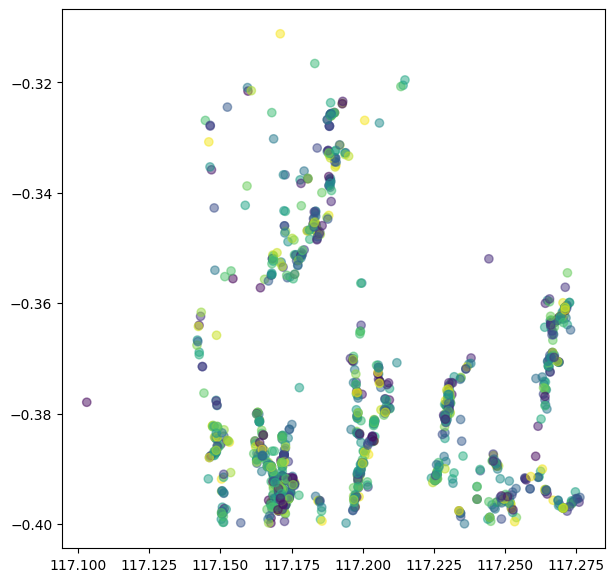

In [58]:
x = location['longitude']
y = location['latitude']

colors = np.random.rand(len(x))

plt.figure(figsize=(7,7))
plt.scatter(x, y,c=colors, alpha=0.5)
plt.show()

In [63]:
import folium
import re

m = folium.Map(location=[df.latitude.median(), df.longitude.median()], zoom_start=11, 
               tiles='OpenStreet Map')

for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row.latitude, row.longitude],
        radius=5,
        popup=re.sub(r'[^a-zA-Z ]+', '', row.kecamatan),
        color='#1787FE',
        fill=True,
        fill_colour='#1787FE'
    ).add_to(m)
    
m

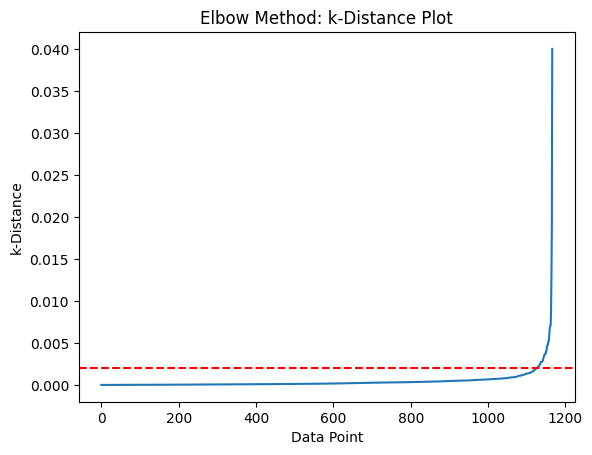

In [67]:
from sklearn.neighbors import NearestNeighbors

XD = location
XD = XD[~np.isnan(XD)]
XD = XD.dropna()

# K-Distance = 2x(Jumlah Dimensi)
nn = NearestNeighbors(n_neighbors=4)
nn = nn.fit(XD)
distances, indices = nn.kneighbors(XD)

distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

# Mengambil nilai epsilon dari elbow
epsilon = 0.002
plt.axhline(y=epsilon, color='r', linestyle='--')
plt.xlabel('Data Point')
plt.ylabel('k-Distance')
plt.title('Elbow Method: k-Distance Plot')
plt.show()

In [68]:
from sklearn import metrics
from sklearn.cluster import DBSCAN

# min_samples=(no. of Dimensions)+1
db = DBSCAN(eps=epsilon, min_samples=5).fit(location)
labels = db.labels_

In [69]:
import pickle

with open('models/dbscan.pkl', 'wb') as file:
    pickle.dump(db, file)

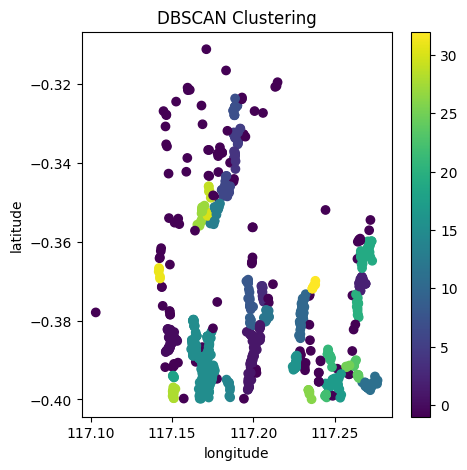

In [76]:
x = location['longitude']
y = location['latitude']

fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(111)
scatter = ax.scatter(x, y, c=labels)
ax.set_title('DBSCAN Clustering')
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')
plt.colorbar(scatter)

In [74]:
core_samples_mask = np.zeros_like(labels, dtype=bool)
core_samples_mask[labels >= 0] = True

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print('======')
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(location, labels))

Estimated number of clusters: 33
Estimated number of noise points: 126
Silhouette Coefficient: 0.429


- Dalam konteks ini, algoritma berpikir bahwa data dapat dibagi menjadi sekitar 33 kelompok berbeda.
- perkiraan jumlah titik data yang dianggap sebagai "noise" atau tidak terikat ke dalam klaster tertentu.
- nilai 0.429, menunjukkan konfigurasi klaster yang dihasilkan relatif baik, tetapi ada ruang untuk perbaikan. 

Catatan :
Nilai Silhouette Coefficient yang lebih tinggi biasanya menunjukkan bahwa objek dalam klaster benar-benar berdekatan dan terpisah dengan baik dari klaster lainnya.